In [1]:
import torch as th
import numpy as np
import argparse
import matplotlib.pyplot as plt
import os
from torch.backends import cudnn
from torchvision.utils import make_grid
from math import sqrt, ceil
from tqdm import tqdm
from scipy.ndimage import gaussian_filter

# turn fast mode on
cudnn.benchmark = True

In [23]:
def adjust_dynamic_range(data, drange_in=(-1, 1), drange_out=(0, 1)):
    """
    adjust the dynamic colour range of the given input data
    :param data: input image data
    :param drange_in: original range of input
    :param drange_out: required range of output
    :return: img => colour range adjusted images
    """
    if drange_in != drange_out:
        scale = (np.float32(drange_out[1]) - np.float32(drange_out[0])) / (np.float32(drange_in[1]) - np.float32(drange_in[0]))
        bias = (np.float32(drange_out[0]) - np.float32(drange_in[0]) * scale)
        data = data * scale + bias
    return th.clamp(data, min=0, max=1)

def progressive_upscaling(images):
    from torch.nn.functional import interpolate
    """
    upsamples all images to the highest size ones
    :param images: list of images with progressively growing resolutions
    :return: images => images upscaled to same size
    """
    with th.no_grad():
        for factor in range(1, len(images)):
            images[len(images) - 1 - factor] = interpolate(
                images[len(images) - 1 - factor],
                scale_factor=pow(2, factor)
            )

    return images

def get_image(gen, point):
    images = list(map(lambda x: x.detach(), gen(point)))
    images = [adjust_dynamic_range(image) for image in images]
    images = progressive_upscaling(images)
    # discard 128_x_128 resolution (temporarily)
    images = images[:-2] + images[-1:]
    images = list(map(lambda x: x.squeeze(dim=0), images))
    image = make_grid(
        images,
        nrow=int(ceil(sqrt(len(images)))),
        padding=0
    )
    return image.cpu().numpy().transpose(1, 2, 0)

In [3]:
gpu_idx = 7
depth = 8
latent_size = 512

device = th.device("cuda:{}".format(gpu_idx) if th.cuda.is_available() else "cpu")

import sys
sys.path.append('/mnt/disk1/yunseob/Pytorch/0_Personal/1_DL/2_GAN/b)_MSG_GAN')
from MSG_GAN.GAN import Generator

# create generator object:
print("Creating a generator object ...")
generator = th.nn.DataParallel(
    Generator(depth=depth,
              latent_size=latent_size), device_ids = [device.index])

generator_file ='MSG_GAN_models_d8/GAN_GEN_1000.pth'

print("loading the trained generator weights ...")
generator.load_state_dict(th.load(generator_file, map_location=lambda storage, loc: storage.cuda(gpu_idx)))

Creating a generator object ...
loading the trained generator weights ...


<All keys matched successfully>

In [20]:
time = 10
fps = 1
smoothing = 2.0

# total_frames in the video:
total_frames = int(time * fps)

# Let's create the animation video from the latent space interpolation
# all latent vectors:
all_latents = th.randn(total_frames, latent_size).to(device)
all_latents_g = gaussian_filter(all_latents.cpu(), [smoothing * fps, 0])
all_latents_g = th.from_numpy(all_latents_g)
all_latents_n = (all_latents_g / all_latents_g.norm(dim=-1, keepdim=True)) \
              * (sqrt(latent_size))

In [21]:
all_latents_n.shape

torch.Size([10, 512])

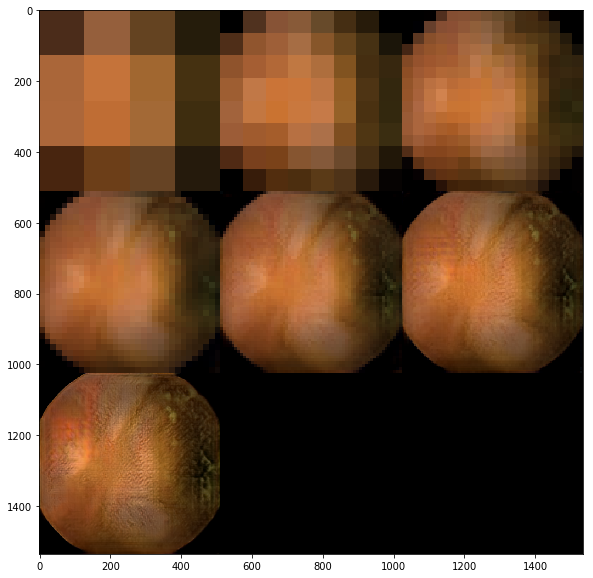

In [24]:
img = get_image(generator, th.unsqueeze(all_latents_n[0], dim = 0))

plt.figure(figsize=(10, 10))

plt.imshow(img)

## Latent Plot

In [260]:
sns.distplot?

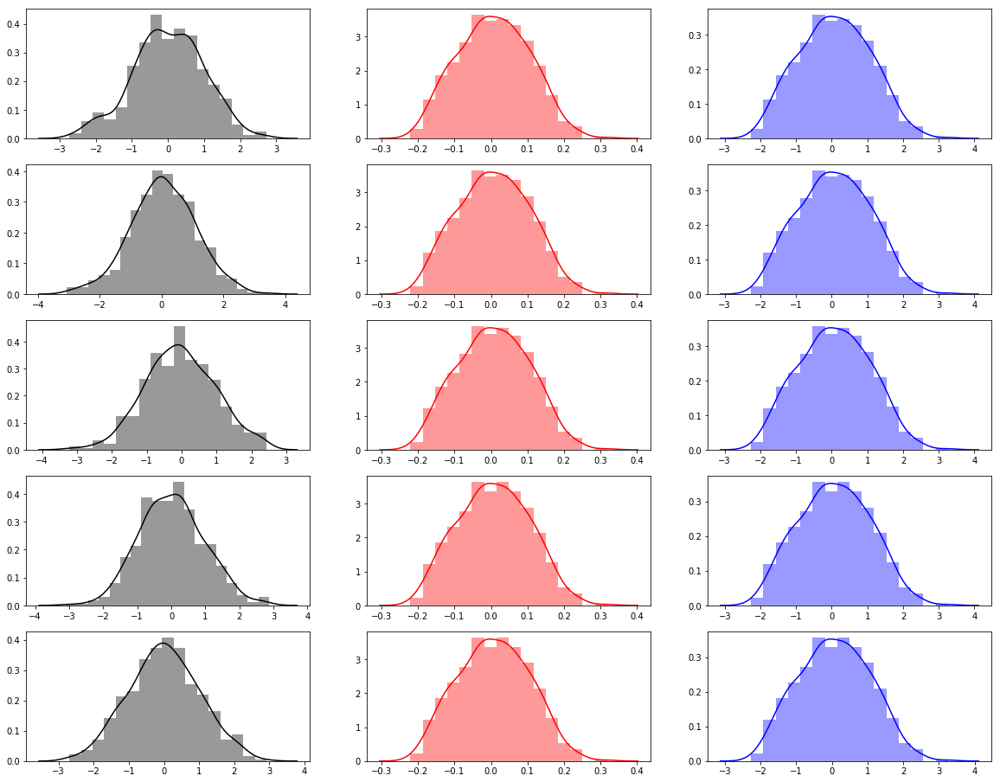

In [266]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, axes = plt.subplots(5, 3)
fig.set_size_inches(20, 16)

sns.distplot(all_latents[0, :].cpu(), color='k', ax = axes[0, 0])
sns.distplot(all_latents_g[0, :].cpu(), color='r', ax = axes[0, 1])
sns.distplot(all_latents_n[0, :].cpu(), color='b', ax = axes[0, 2])
# sns.distplot(all_latents[0, :].cpu(), color='gray', ax = axes[1, 0])
# sns.distplot(all_latents_g[0, :].cpu(), color='darksalmon', ax = axes[1, 1])
# sns.distplot(all_latents_n[0, :].cpu(), color='cornflowerblue', ax = axes[1, 2])

sns.distplot(all_latents[1, :].cpu(), color='k', ax = axes[1, 0])
sns.distplot(all_latents_g[1, :].cpu(), color='r', ax = axes[1, 1])
sns.distplot(all_latents_n[1, :].cpu(), color='b', ax = axes[1, 2])
# sns.distplot(all_latents[1, :].cpu(), color='gray', ax = axes[2, 0])
# sns.distplot(all_latents_g[1, :].cpu(), color='darksalmon', ax = axes[2, 1])
# sns.distplot(all_latents_n[1, :].cpu(), color='cornflowerblue', ax = axes[2, 2])

sns.distplot(all_latents[2, :].cpu(), color='k', ax = axes[2, 0])
sns.distplot(all_latents_g[2, :].cpu(), color='r', ax = axes[2, 1])
sns.distplot(all_latents_n[2, :].cpu(), color='b', ax = axes[2, 2])
# sns.distplot(all_latents[2, :].cpu(), color='gray', ax = axes[3, 0])
# sns.distplot(all_latents_g[2, :].cpu(), color='darksalmon', ax = axes[3, 1])
# sns.distplot(all_latents_n[2, :].cpu(), color='cornflowerblue', ax = axes[3, 2])

sns.distplot(all_latents[3, :].cpu(), color='k', ax = axes[3, 0])
sns.distplot(all_latents_g[3, :].cpu(), color='r', ax = axes[3, 1])
sns.distplot(all_latents_n[3, :].cpu(), color='b', ax = axes[3, 2])
# sns.distplot(all_latents[3, :].cpu(), color='gray', ax = axes[4, 0])
# sns.distplot(all_latents_g[3, :].cpu(), color='darksalmon', ax = axes[4, 1])
# sns.distplot(all_latents_n[3, :].cpu(), color='cornflowerblue', ax = axes[4, 2])

sns.distplot(all_latents[4, :].cpu(), color='k', ax = axes[4, 0])
sns.distplot(all_latents_g[4, :].cpu(), color='r', ax = axes[4, 1])
sns.distplot(all_latents_n[4, :].cpu(), color='b', ax = axes[4, 2])

<StemContainer object of 3 artists>

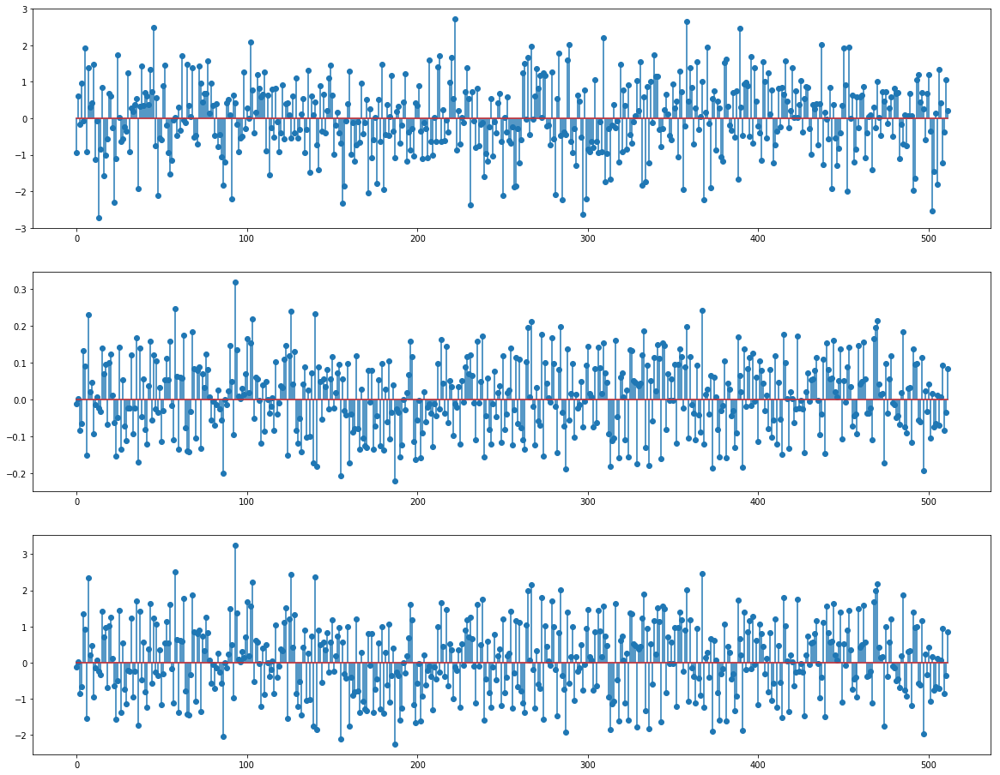

In [268]:
fig, axes = plt.subplots(3, 1)
fig.set_size_inches(20, 16)

axes[0].stem(all_latents[0, :].cpu())
axes[1].stem(all_latents_g[0, :].cpu())
axes[2].stem(all_latents_n[0, :].cpu())

<StemContainer object of 3 artists>

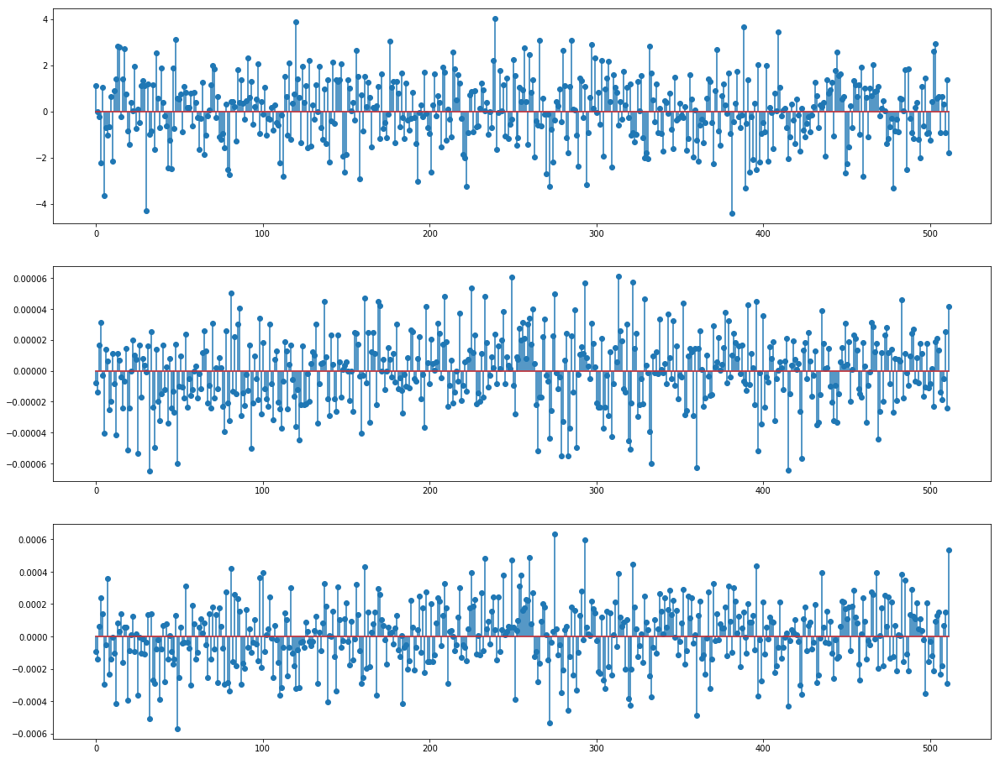

In [272]:
fig, axes = plt.subplots(3, 1)
fig.set_size_inches(20, 16)

axes[0].stem(all_latents[1, :].cpu() - all_latents[0, :].cpu())
axes[1].stem(all_latents_g[1, :].cpu() - all_latents_g[0, :].cpu())
axes[2].stem(all_latents_n[1, :].cpu() - all_latents_n[0, :].cpu())

<StemContainer object of 3 artists>

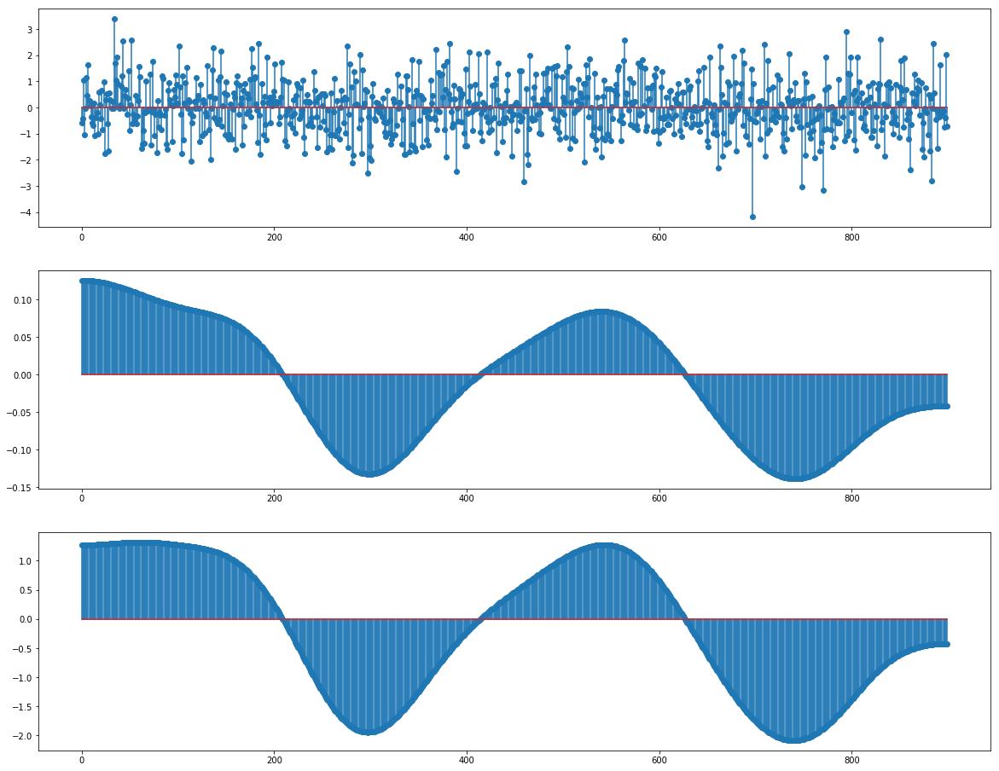

In [64]:
fig, axes = plt.subplots(3, 1)
fig.set_size_inches(20, 16)

axes[0].stem(all_latents[:, 0].cpu())
axes[1].stem(all_latents_g[:, 0].cpu())
axes[2].stem(all_latents_n[:, 0].cpu())

<StemContainer object of 3 artists>

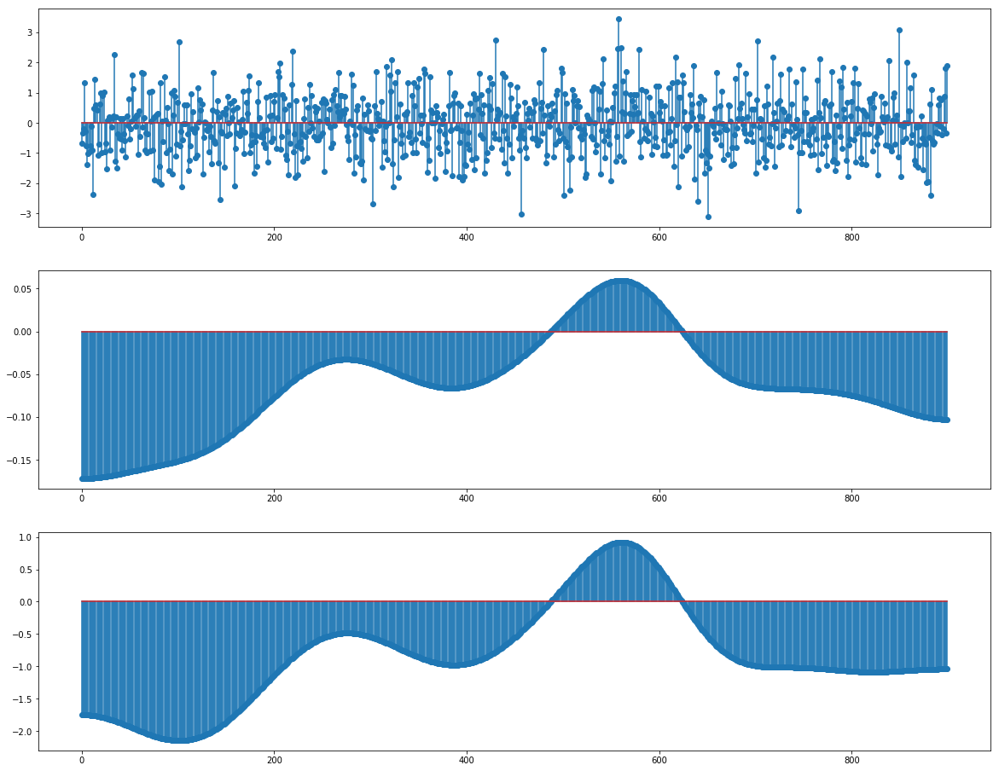

In [65]:
fig, axes = plt.subplots(3, 1)
fig.set_size_inches(20, 16)

axes[0].stem(all_latents[:, 1].cpu())
axes[1].stem(all_latents_g[:, 1].cpu())
axes[2].stem(all_latents_n[:, 1].cpu())

<StemContainer object of 3 artists>

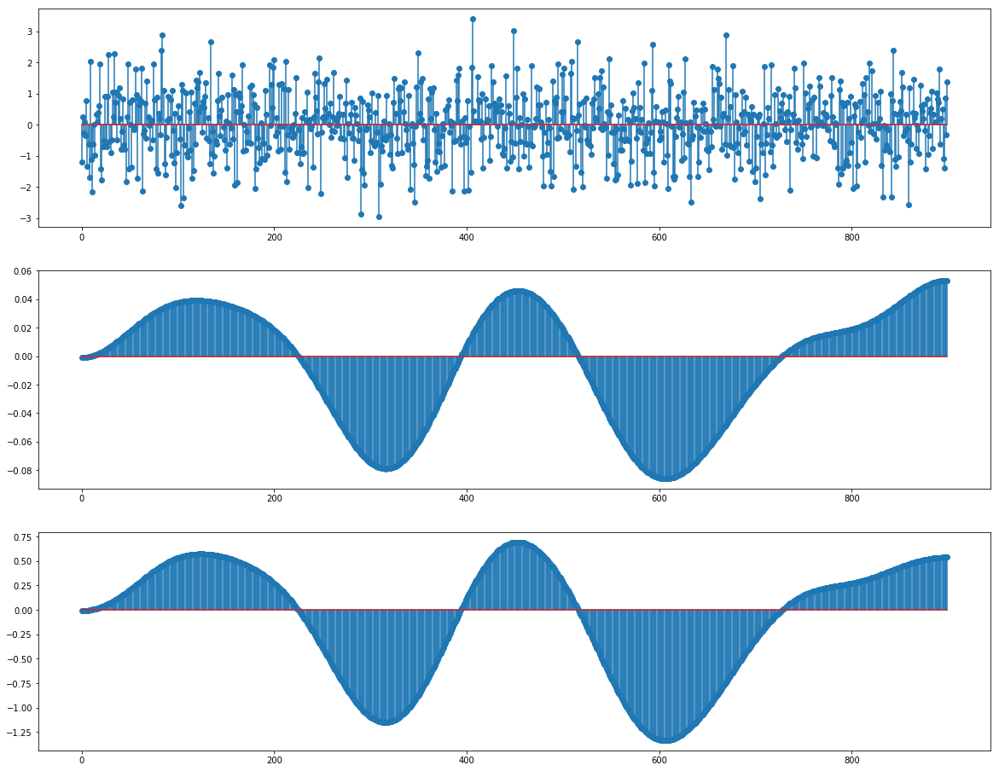

In [66]:
fig, axes = plt.subplots(3, 1)
fig.set_size_inches(20, 16)

axes[0].stem(all_latents[:, 2].cpu())
axes[1].stem(all_latents_g[:, 2].cpu())
axes[2].stem(all_latents_n[:, 2].cpu())

In [17]:
dif_0 = []
for i in range(len(all_latents_n)):
    if i != (len(all_latents_n) - 1):
        dif_0.append(all_latents[i, 0].item() - all_latents[i+1, 0].item())
        
dif_1 = []
for i in range(len(all_latents_n)):
    if i != (len(all_latents_n) - 1):
        dif_1.append(all_latents[i, 1].item() - all_latents[i+1, 1].item())
        
dif_2 = []
for i in range(len(all_latents_n)):
    if i != (len(all_latents_n) - 1):
        dif_2.append(all_latents[i, 2].item() - all_latents[i+1, 2].item())

<StemContainer object of 3 artists>

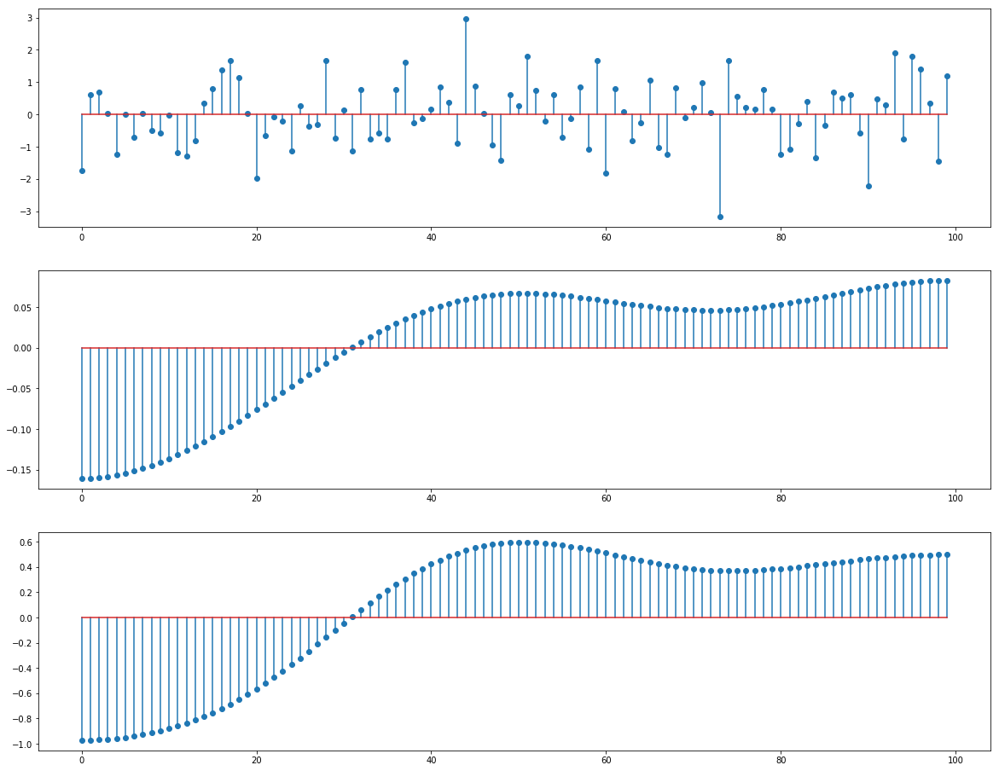

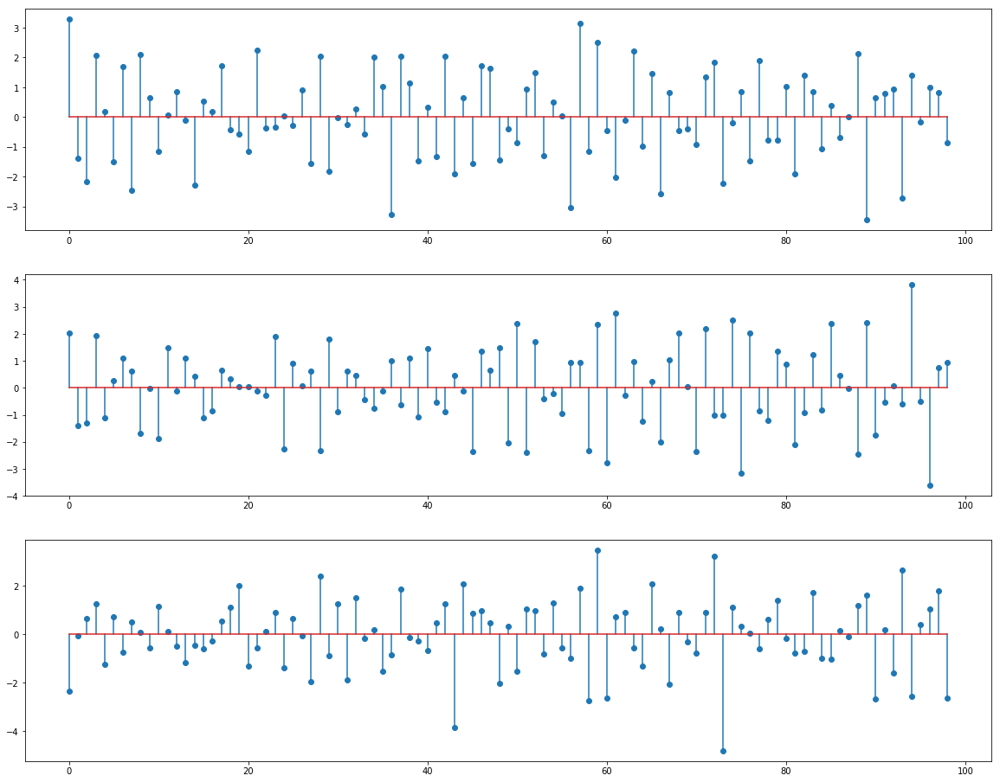

In [18]:
fig, axes = plt.subplots(3, 1)
fig.set_size_inches(20, 16)

axes[0].stem(all_latents[:, 2].cpu())
axes[1].stem(all_latents_g[:, 2].cpu())
axes[2].stem(all_latents_n[:, 2].cpu())

fig, axes = plt.subplots(3, 1)
fig.set_size_inches(20, 16)

axes[0].stem(dif_0)
axes[1].stem(dif_1)
axes[2].stem(dif_2)

# Function get_image

In [132]:
images = list(map(lambda x: x.detach(), generator(th.unsqueeze(all_latents_n[0], dim = 0))))

In [153]:
images[-1].min(), images[-1].max(), images[-1].mean()

(tensor(-1.7613, device='cuda:7'),
 tensor(0.8736, device='cuda:7'),
 tensor(-0.4647, device='cuda:7'))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


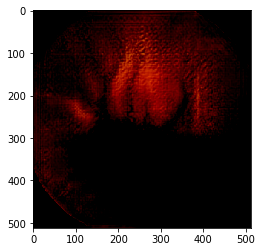

In [150]:
plt.imshow(images[-1].cpu().numpy().transpose(0, 2, 3, 1)[0])

In [154]:
images = [adjust_dynamic_range(image) for image in images]

(tensor(0., device='cuda:7'),
 tensor(0.9368, device='cuda:7'),
 tensor(0.2719, device='cuda:7'))

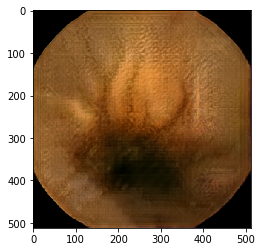

In [156]:
plt.imshow(images[-1].cpu().numpy().transpose(0, 2, 3, 1)[0])
images[-1].min(), images[-1].max(), images[-1].mean()

In [180]:
int(ceil(sqrt(len(imgs))))

4

In [182]:
sqrt(len(imgs))

3.1622776601683795

In [183]:
ceil(3.16)

4

# customization

## modify each dim in latent space

In [84]:
all_latents_new = all_latents_n.detach()

In [97]:
all_latents_new[:, 0].mean(), all_latents_new[:, 0].min(), all_latents_new[:, 0].max()

(tensor(0.5926), tensor(-1.4180), tensor(3.2950))

In [198]:
all_latents_new[:, 1].mean(), all_latents_new[:, 1].min(), all_latents_new[:, 1].max()

(tensor(-0.3764), tensor(-1.1979), tensor(0.3654))

In [199]:
all_latents_new.max()

tensor(3.6725)

In [200]:
all_latents_new.min()

tensor(-4.0324)

In [89]:
latents_ref = all_latents_new[0].detach()

In [98]:
th.arange(-1.5, 3.3, 0.1)

tensor([-1.5000, -1.4000, -1.3000, -1.2000, -1.1000, -1.0000, -0.9000, -0.8000,
        -0.7000, -0.6000, -0.5000, -0.4000, -0.3000, -0.2000, -0.1000,  0.0000,
         0.1000,  0.2000,  0.3000,  0.4000,  0.5000,  0.6000,  0.7000,  0.8000,
         0.9000,  1.0000,  1.1000,  1.2000,  1.3000,  1.4000,  1.5000,  1.6000,
         1.7000,  1.8000,  1.9000,  2.0000,  2.1000,  2.2000,  2.3000,  2.4000,
         2.5000,  2.6000,  2.7000,  2.8000,  2.9000,  3.0000,  3.1000,  3.2000])

In [172]:
th.linspace(-1.5, 3.3, 10)

tensor([-1.5000, -0.9667, -0.4333,  0.1000,  0.6333,  1.1667,  1.7000,  2.2333,
         2.7667,  3.3000])

In [99]:
latents_ref[0]

tensor(-0.1116)

In [173]:
all_latents_ref = [latents_ref for _ in range(len(th.linspace(-1.5, 3.3, 10)))]

In [174]:
all_latents_ref = th.stack(all_latents_ref)

In [175]:
all_latents_ref[:, 0] = th.linspace(-1.5, 3.3, 10)

In [176]:
all_latents_ref[:, 0]

tensor([-1.5000, -0.9667, -0.4333,  0.1000,  0.6333,  1.1667,  1.7000,  2.2333,
         2.7667,  3.3000])

In [225]:
all_latents_ref[:, 5]

tensor([0.9260, 0.9260, 0.9260, 0.9260, 0.9260, 0.9260, 0.9260, 0.9260, 0.9260,
        0.9260])

In [236]:
def get_highest_image(gen, point):
    
    images = list(map(lambda x: x.detach(), gen(point)))
    image = adjust_dynamic_range(images[-1])[0]

    return image.cpu().numpy().transpose(1, 2, 0)

In [168]:
img = get_highest_image(generator, th.unsqueeze(all_latents_ref[0], dim=0))

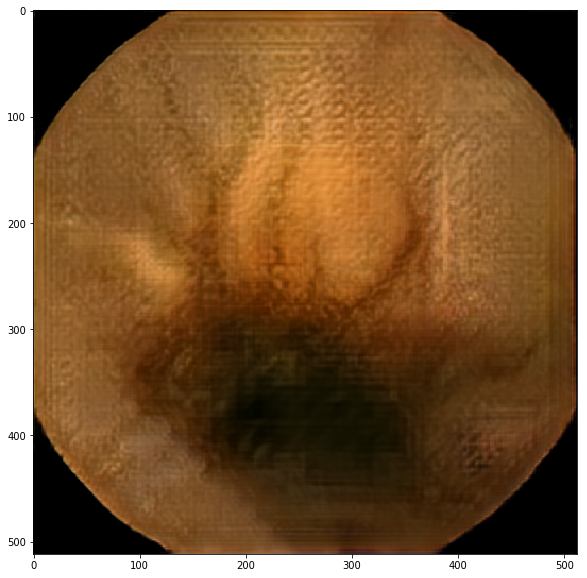

In [169]:
plt.figure(figsize=(10, 10))

plt.imshow(img)

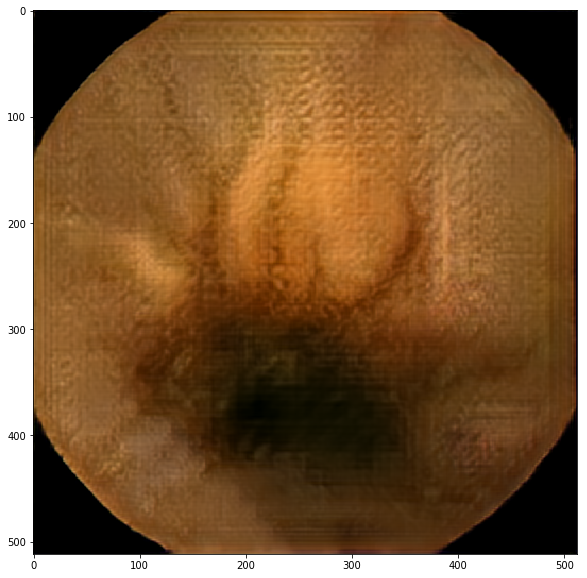

In [237]:
img = get_highest_image(generator, th.unsqueeze(all_latents_n[0], dim=0))

plt.figure(figsize=(10, 10))

plt.imshow(img)

In [241]:
def get_highest_image(gen, point):
    
    images = list(map(lambda x: x.detach(), gen(point)))
    image = adjust_dynamic_range(images[-1])[0]

    return image

In [179]:
imgs = []
for latent in all_latents_ref:
    img = get_highest_image(generator, th.unsqueeze(latent, dim=0))
    imgs.append(img)

In [186]:
make_grid?

In [194]:
image.shape

torch.Size([3, 512, 5120])

In [195]:
image = image.cpu().numpy().transpose(1, 2, 0)

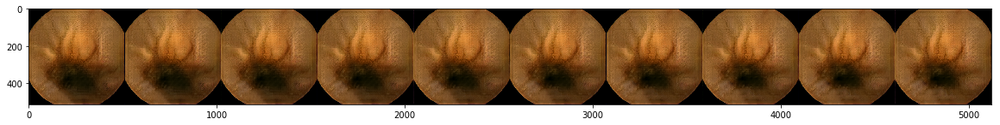

In [196]:
plt.figure(figsize=(20, 5))

plt.imshow(image)

### modification after gaussian filter

In [249]:
def latent_interpolation(gen, point, target = 0):
    point = point.detach()
    variance = th.linspace(point.min(), point.max(), 10)
    latents_ref = [point for _ in range(len(variance))] 
    latents_ref = th.stack(latents_ref)
    latents_ref[:, target] = variance
#     print(target, latents_ref[:, target])
    images = []
    for latent in latents_ref:
        image = get_highest_image(gen, th.unsqueeze(latent, dim=0))
        images.append(image)     
    image = make_grid(
        images,
        nrow=10,
        padding=0
    )
    return image.cpu().numpy().transpose(1, 2, 0)
    

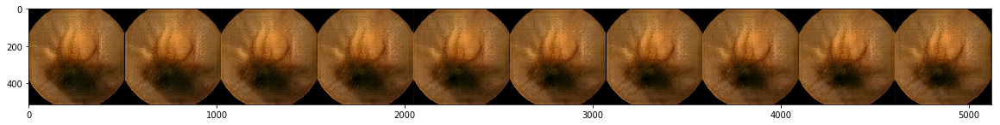

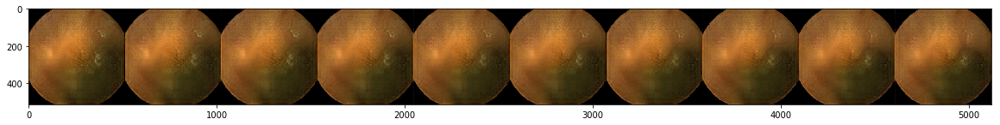

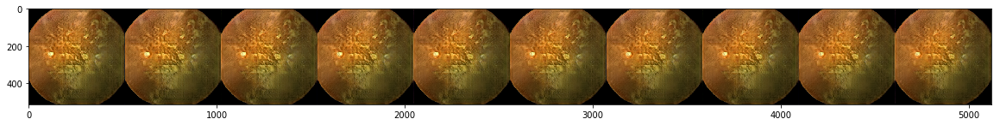

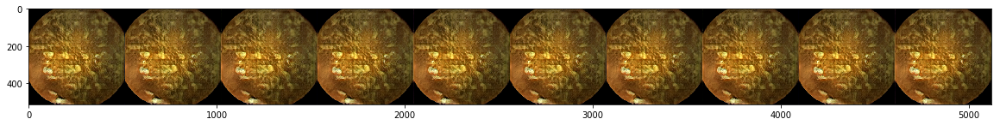

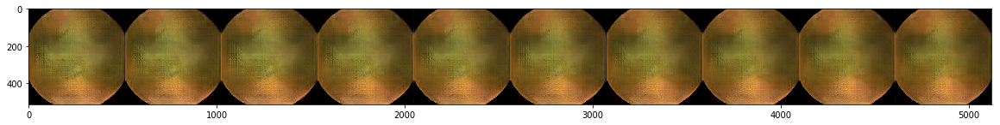

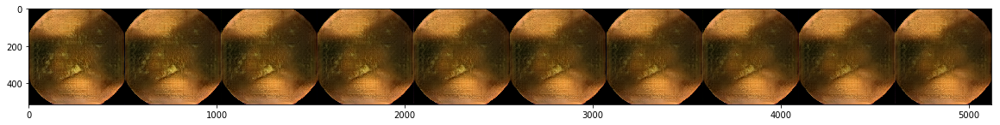

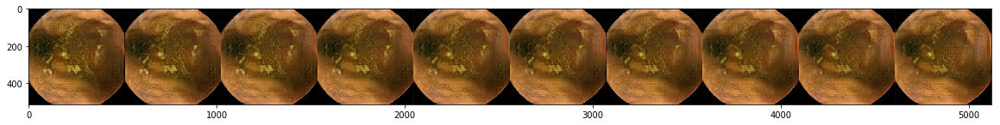

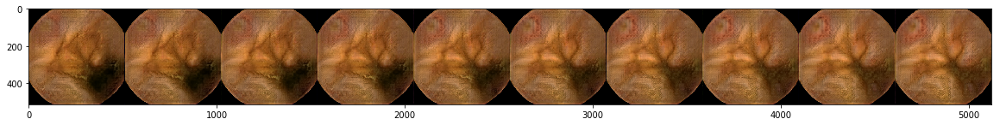

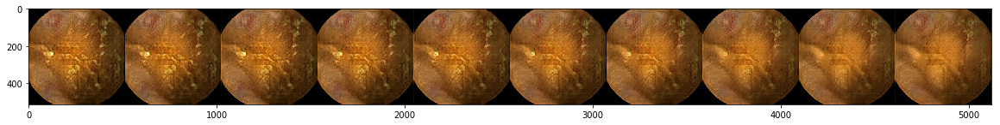

In [255]:
for i in range(9):

    img = latent_interpolation(generator, all_latents_n[i*100], target = 0)

    plt.figure(figsize=(20, 5))

    plt.imshow(img)

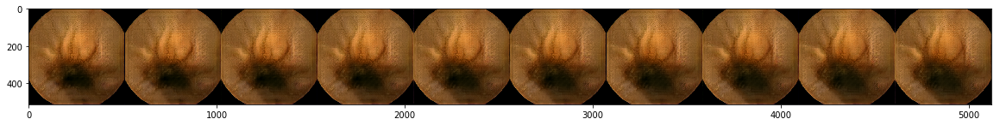

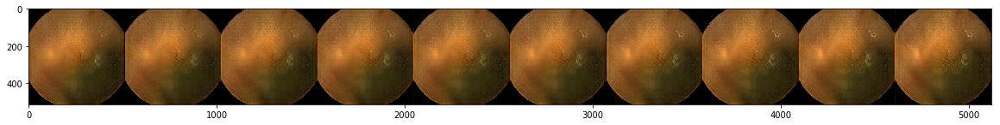

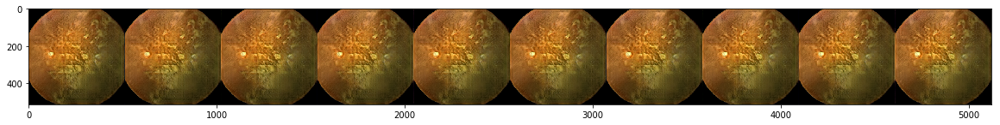

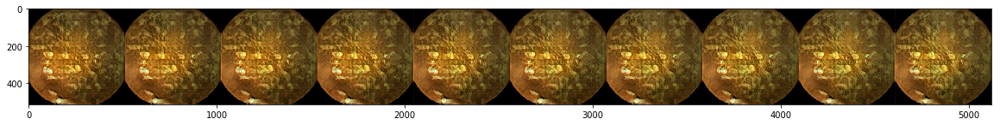

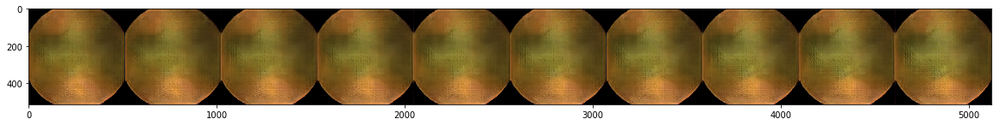

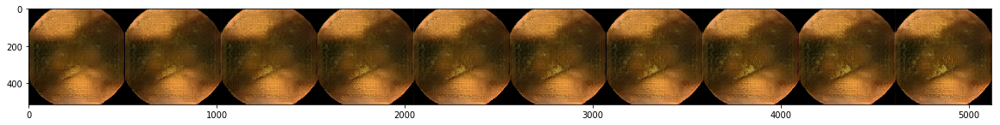

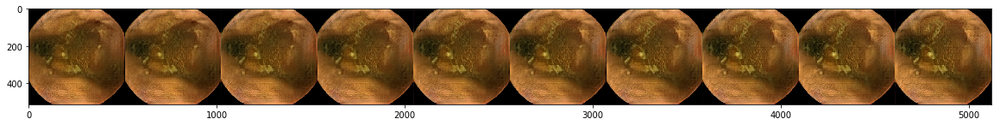

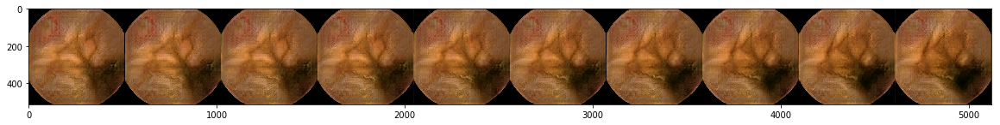

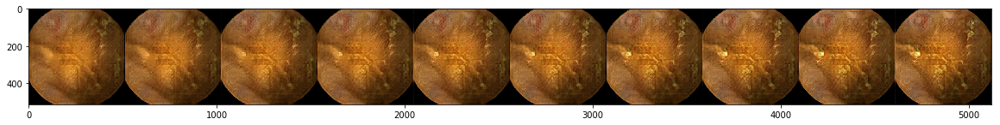

In [257]:
for i in range(9):

    img = latent_interpolation(generator, all_latents_n[i*100], target = 1)

    plt.figure(figsize=(20, 5))

    plt.imshow(img)

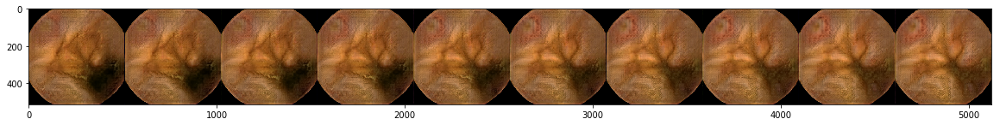

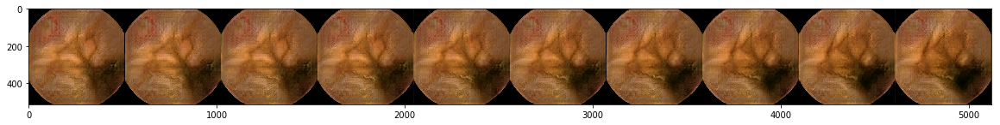

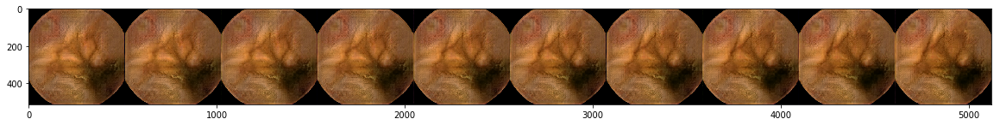

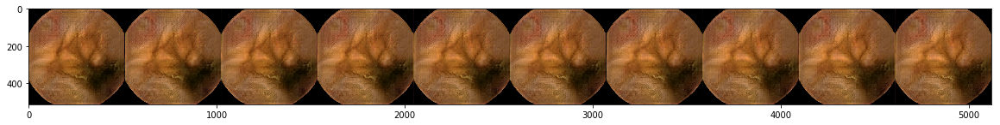

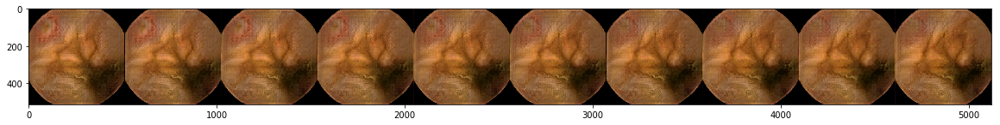

...

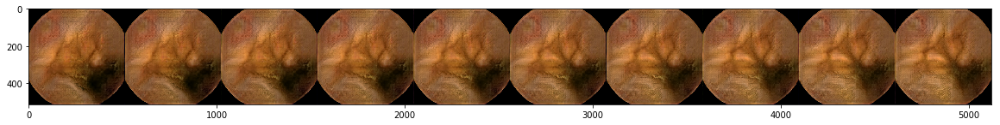

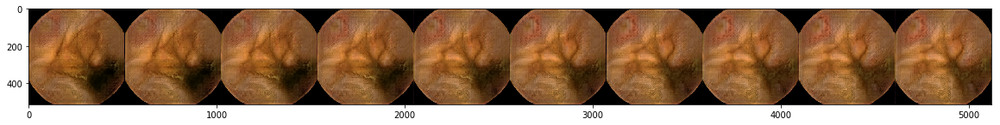

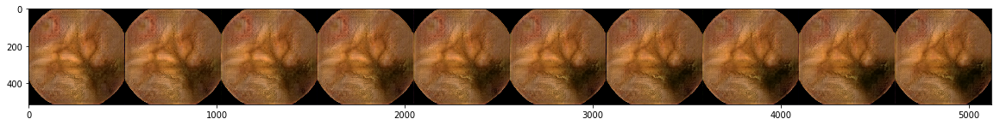

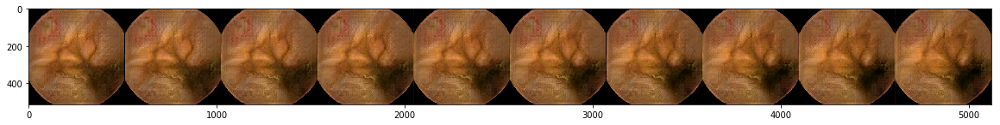

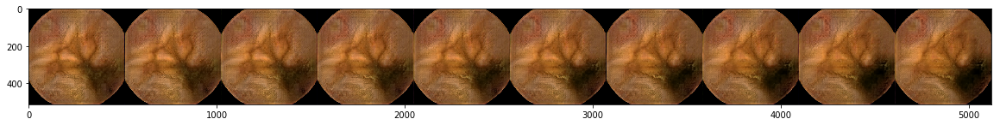

In [258]:
for i in range(30):

    img = latent_interpolation(generator, all_latents_n[700], target = i)

    plt.figure(figsize=(20, 5))

    plt.imshow(img)

### modification before gaussian filter

In [244]:
def latent_interpolation(gen, point, target = 0):
    
    smoothing = 2
    fps = 1 
    
    point = point.detach()  
#     variance = th.linspace(point.min(), point.max(), 10)
    variance = th.linspace(point.min()*1.2, point.max()*1.2, 10)
    latents_ref = [point for _ in range(len(variance))] 
    latents_ref = th.stack(latents_ref)
    latents_ref[:, target] = variance
    
    latents_ref = gaussian_filter(latents_ref.cpu(), [2, 0])
    latents_ref = th.from_numpy(latents_ref)
    latents_ref = (latents_ref / latents_ref.norm(dim=-1, keepdim=True)) \
                  * (sqrt(latent_size))
    
#     print(target, latents_ref[:, target])
    images = []
    for latent in latents_ref:
        image = get_highest_image(gen, th.unsqueeze(latent, dim=0))
        images.append(image)     
    
    image = make_grid(
        images,
        nrow=10,
        padding=0
    )
    return image.cpu().numpy().transpose(1, 2, 0)
    

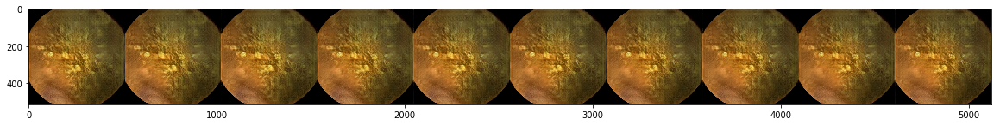

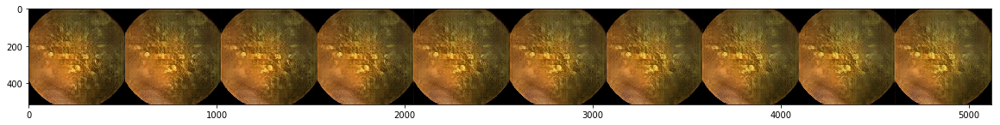

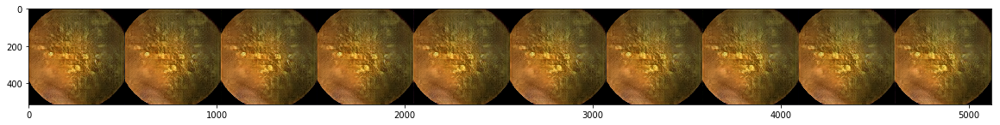

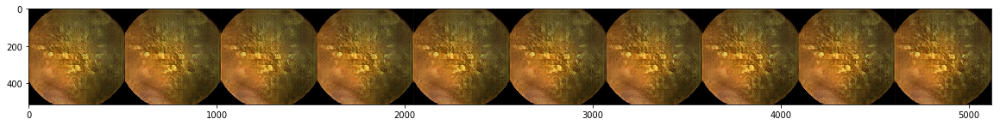

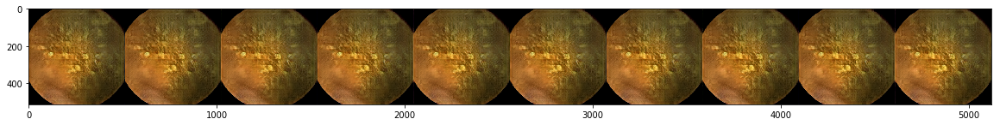

...

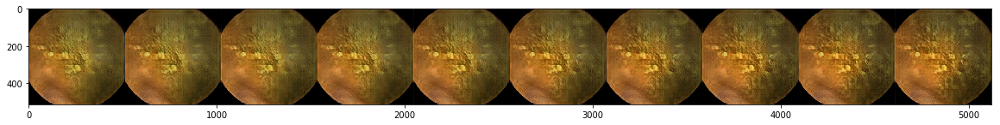

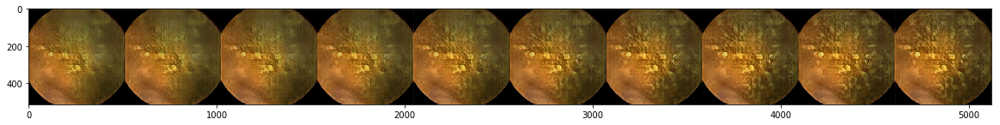

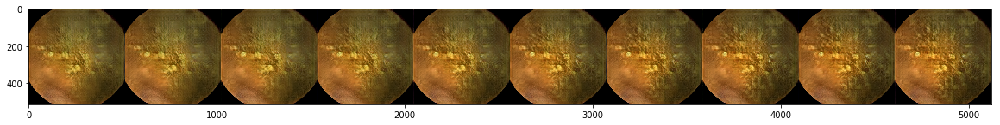

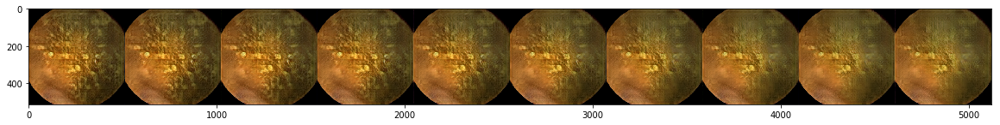

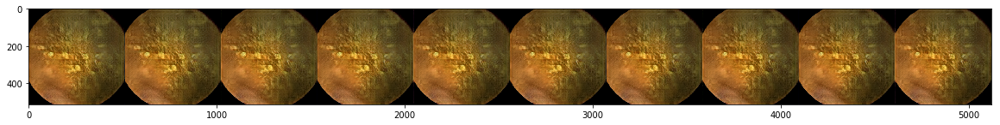

Error in callback <function flush_figures at 0x7fbea0d90048> (for post_execute):


KeyboardInterrupt: 

In [245]:
for i in range(30):

    img = latent_interpolation(generator, all_latents[2], target = i)

    plt.figure(figsize=(20, 5))

    plt.imshow(img)

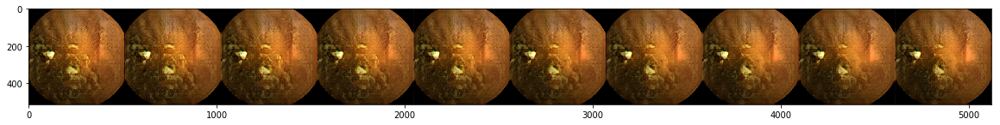

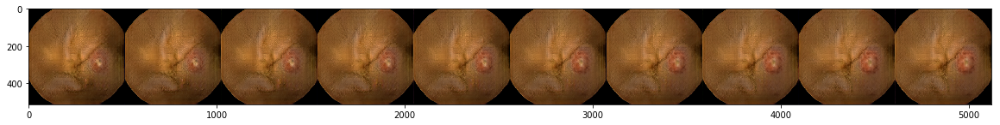

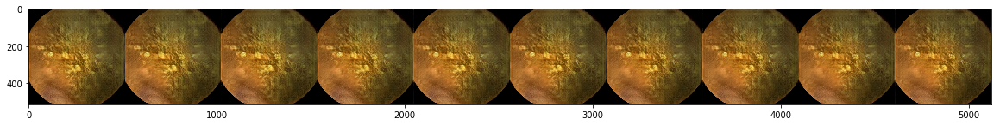

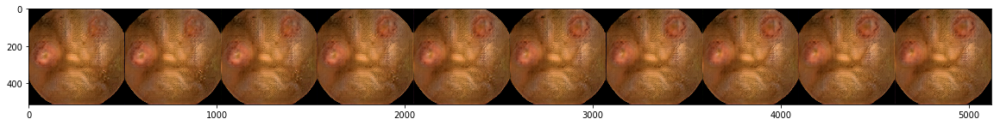

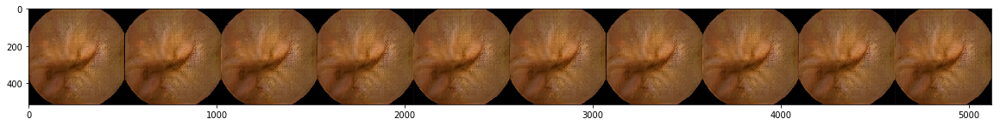

...

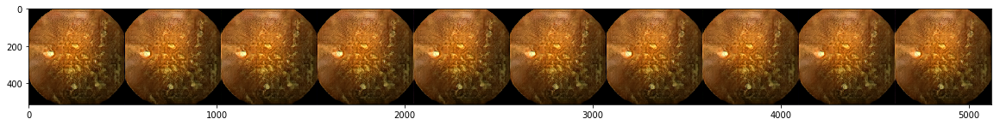

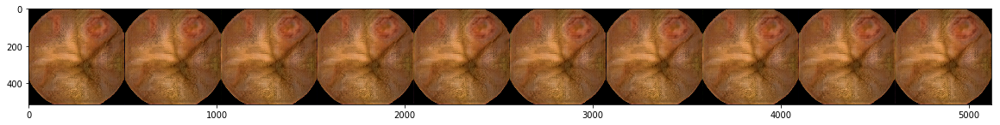

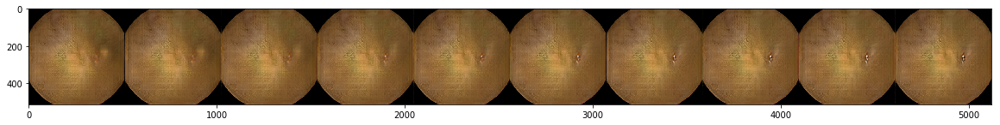

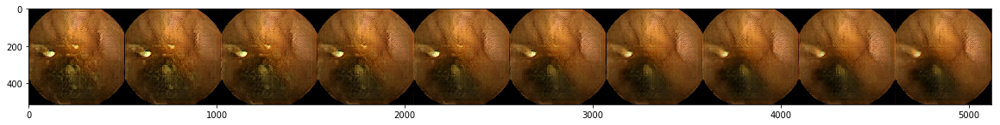

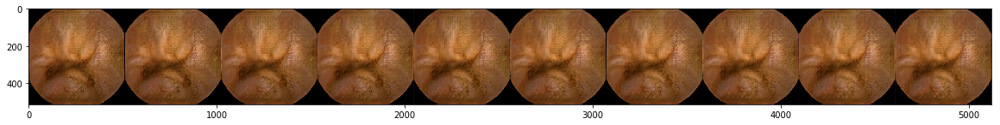

In [246]:
for i in range(30):

    img = latent_interpolation(generator, all_latents[i], target = 0)

    plt.figure(figsize=(20, 5))

    plt.imshow(img)

- 어떤 $z$축 $z_{i}$가 어떤 특성을 기반으로 변한닥고 말하기 너무 어려움

### no...

- 그냥 각 랜덤하게 샘플 한 줄 한 줄 interpolation하기 

In [275]:
all_latents_g.shape

torch.Size([100, 512])

In [86]:
def get_highest_image(gen, point):
    
    images = list(map(lambda x: x.detach(), gen(point)))
    image = adjust_dynamic_range(images[-1])[0]

    return image

def latent_interpolation_1d(gen, points):
    points = points.detach()  

    images = []
    for latent in points:
        image = get_highest_image(gen, th.unsqueeze(latent, dim=0))
        images.append(image)     
    
    image = make_grid(
        images,
        nrow=len(points),
        padding=0
    )
    
    return image.cpu().numpy().transpose(1, 2, 0)
    

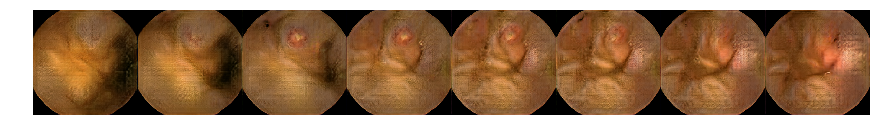

In [45]:
time = 8
fps = 1
smoothing = 2.0

# total_frames in the video:
total_frames = int(time * fps)

# Let's create the animation video from the latent space interpolation
# all latent vectors:
all_latents = th.randn(total_frames, latent_size).to(device)
all_latents_g = gaussian_filter(all_latents.cpu(), [smoothing * fps, 0])
all_latents_g = th.from_numpy(all_latents_g)
all_latents_n = (all_latents_g / all_latents_g.norm(dim=-1, keepdim=True)) \
              * (sqrt(latent_size))

image = latent_interpolation(generator, all_latents_n)

plt.figure(figsize=(15, 15))
plt.imshow(image)
plt.axis('off')
plt.show()

In [346]:
latent_size = 512

time = 8
fps = 1
smoothing = 2.0

# total_frames in the video:
total_frames = int(time * fps)

out_dir = './MSG_GAN_latent_interpolation_d8/'

os.makedirs(out_dir, exist_ok=True)

global_frame_counter = 1
# Run the main loop for the interpolation:
for _ in range(10):

    images = []
    for _ in range(8):

        

        # Let's create the animation video from the latent space interpolation
        # all latent vectors:
        all_latents = th.randn(total_frames, latent_size).to(device)
        all_latents_g = gaussian_filter(all_latents.cpu(), [smoothing * fps, 0])
        all_latents_g = th.from_numpy(all_latents_g)
        all_latents_n = (all_latents_g / all_latents_g.norm(dim=-1, keepdim=True)) \
                      * (sqrt(latent_size))

        image = latent_interpolation(generator, all_latents_n)
        images.append(image)

    image = np.concatenate(images)
    
#     plt.figure(figsize=(15, 15))
#     plt.imshow(image)
#     plt.axis('off')
#     plt.show()

    plt.imsave(os.path.join(out_dir, '{:02d}'.format(global_frame_counter) + ".png"), image)
    
    global_frame_counter += 1

ValueError: Format 'jpg' is not supported (supported formats: eps, pdf, pgf, png, ps, raw, rgba, svg, svgz)

## bilinear interpolation

In [85]:
len(all_latents_n)

10

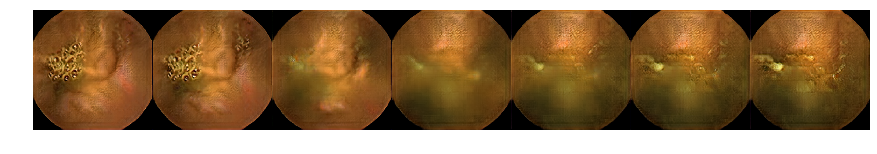

In [359]:
time = 7
fps = 1
smoothing = 2.0

# total_frames in the video:
total_frames = int(time * fps)

# Let's create the animation video from the latent space interpolation
# all latent vectors:
all_latents = th.randn(total_frames, latent_size).to(device)
all_latents_g = gaussian_filter(all_latents.cpu(), [smoothing * fps, 0])
all_latents_g = th.from_numpy(all_latents_g)
all_latents_n = (all_latents_g / all_latents_g.norm(dim=-1, keepdim=True)) \
              * (sqrt(latent_size))

image = latent_interpolation_1d(generator, all_latents_n)

plt.figure(figsize=(15, 15))
plt.imshow(image)
plt.axis('off')
plt.show()

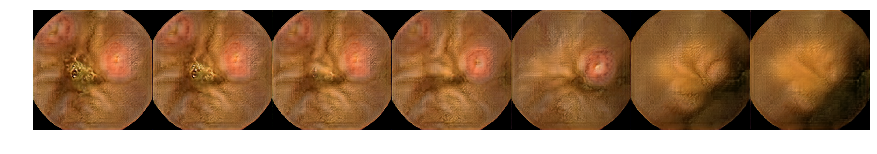

In [362]:
all_latents = th.randn(total_frames, latent_size).to(device)
all_latents_g = gaussian_filter(all_latents.cpu(), [smoothing * fps, 0])
all_latents_g = th.from_numpy(all_latents_g)
all_latents_n2 = (all_latents_g / all_latents_g.norm(dim=-1, keepdim=True)) \
              * (sqrt(latent_size))

image = latent_interpolation(generator, all_latents_n2)

plt.figure(figsize=(15, 15))
plt.imshow(image)
plt.axis('off')
plt.show()

In [171]:
def mapping_bilinear_latents(latents_1, latents_2, n_row = None):
    assert latents_1.shape == latents_2.shape, 'dimensionality of latent must be equal'
    n_col, latent_size = latents_1.shape
    
    if n_row == None:
        n_row = n_col
    
    latents_2d = th.zeros(n_row, n_col, latent_size)
    
    latents_2d[0, :, :] = latents_1
    latents_2d[n_row-1, :, :] = latents_2
    
    for i in range(1, n_row-1):
        latents_2d[i, :, :] = (n_row-1-i)/(n_row-1)*latents_1 + i/(n_row-1)*latents_2
    return latents_2d
    

def latent_interpolation_2d(gen, points):
    
    points = points.detach()  
    
    n_row, n_col, _ = points.shape
    
    total_images = []
    for r in range(n_row):
        row_images = []
        for latent in points[r]:
            row_image = get_highest_image(gen, th.unsqueeze(latent, dim=0))
            row_images.append(row_image)     

        row_image = make_grid(
            row_images,
            nrow=n_col,
            padding=0
        )
        total_images.append(row_image.cpu().numpy().transpose(1, 2, 0))
        
    total_images = np.concatenate(total_images)

    return total_images

import cv2

def save_image_cv2(filename, image, image_ch = 'rgb'):
    if image.dtype == np.float32:
        image = (image*255).astype('uint8')
    if image_ch == 'rgb':
        image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    cv2.imwrite(filename, image)
    
out_dir = './MSG_GAN_latent_interpolation_d8/'

In [366]:
save_image_cv2(out_dir + 'bilinear_interp_10_7row.jpg', total_images)

In [364]:
save_image_cv2(out_dir + 'bilinear_interp_10_5row.jpg', total_images)

In [346]:
save_image_cv2(out_dir + 'bilinear_interp_9_5row.jpg', total_images)
save_image_cv2(out_dir + 'bilinear_interp_9_7row.jpg', total_images)

In [329]:
save_image_cv2(out_dir + 'bilinear_interp_8_5row.jpg', total_images)

In [327]:
save_image_cv2(out_dir + 'bilinear_interp_8_7row.jpg', total_images)

In [273]:
save_image_cv2(out_dir + 'bilinear_interp_7_5row.jpg', total_images)

In [275]:
save_image_cv2(out_dir + 'bilinear_interp_7_7row.jpg', total_images)

In [252]:
save_image_cv2(out_dir + 'bilinear_interp_6.jpg', total_images)

In [244]:
save_image_cv2(out_dir + 'bilinear_interp_1_7rows.jpg', total_images6)

In [231]:
save_image_cv2(out_dir + 'bilinear_interp_1.jpg', total_images5)
save_image_cv2(out_dir + 'bilinear_interp_2.jpg', total_images4)
save_image_cv2(out_dir + 'bilinear_interp_3.jpg', total_images3)
save_image_cv2(out_dir + 'bilinear_interp_4.jpg', total_images2)
save_image_cv2(out_dir + 'bilinear_interp_5.jpg', total_images)

In [1]:
import torch as th
import sys
sys.path.append('/mnt/disk1/yunseob/Pytorch/0_Personal/3_CelebA/2_GAN/b)_MSG_GAN')
from MSG_GAN.GAN import Generator




In [2]:
gpu_idx = 4

device = th.device("cuda:{}".format(gpu_idx) if th.cuda.is_available() else "cpu")

In [3]:
depth = 7
latent_size = 512

# create generator object:
print("Creating a generator object ...")
generator = th.nn.DataParallel(
    Generator(depth=depth,
              latent_size=latent_size).to(device))

Creating a generator object ...


In [4]:
generator

DataParallel(
  (module): Generator(
    (layers): ModuleList(
      (0): GenInitialBlock(
        (conv_1): _equalized_deconv2d(512, 512, 4, 4)
        (conv_2): _equalized_conv2d(512, 512, 3, 3)
        (pixNorm): PixelwiseNorm()
        (lrelu): LeakyReLU(negative_slope=0.2)
      )
      (1): GenGeneralConvBlock(
        (conv_1): _equalized_conv2d(512, 512, 3, 3)
        (conv_2): _equalized_conv2d(512, 512, 3, 3)
        (pixNorm): PixelwiseNorm()
        (lrelu): LeakyReLU(negative_slope=0.2)
      )
      (2): GenGeneralConvBlock(
        (conv_1): _equalized_conv2d(512, 512, 3, 3)
        (conv_2): _equalized_conv2d(512, 512, 3, 3)
        (pixNorm): PixelwiseNorm()
        (lrelu): LeakyReLU(negative_slope=0.2)
      )
      (3): GenGeneralConvBlock(
        (conv_1): _equalized_conv2d(512, 512, 3, 3)
        (conv_2): _equalized_conv2d(512, 512, 3, 3)
        (pixNorm): PixelwiseNorm()
        (lrelu): LeakyReLU(negative_slope=0.2)
      )
      (4): GenGeneralConvBlock(
   

In [8]:
generator_file = 'MSG_GAN_models_d7/GAN_GEN_761.pth'

print("loading the trained generator weights ...")
generator.load_state_dict(th.load(generator_file, map_location=lambda storage, loc: storage.cuda(gpu_idx)))

loading the trained generator weights ...


<All keys matched successfully>

In [7]:
th.load?